<a href="https://www.kaggle.com/code/taha3012000/airline-ml-dl?scriptVersionId=121357515" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import pandas_profiling
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/airline-passenger-satisfaction/train.csv
/kaggle/input/airline-passenger-satisfaction/test.csv


Load data

In [2]:
data=pd.read_csv('/kaggle/input/airline-passenger-satisfaction/train.csv')
data.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


**Preprocessing**

In [3]:
data.shape

(103904, 25)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location                      1039

There is a missing values in "Arrival Delay in Minutes" column

In [5]:
data.isna().sum()/len(data)

Unnamed: 0                           0.000000
id                                   0.000000
Gender                               0.000000
Customer Type                        0.000000
Age                                  0.000000
Type of Travel                       0.000000
Class                                0.000000
Flight Distance                      0.000000
Inflight wifi service                0.000000
Departure/Arrival time convenient    0.000000
Ease of Online booking               0.000000
Gate location                        0.000000
Food and drink                       0.000000
Online boarding                      0.000000
Seat comfort                         0.000000
Inflight entertainment               0.000000
On-board service                     0.000000
Leg room service                     0.000000
Baggage handling                     0.000000
Checkin service                      0.000000
Inflight service                     0.000000
Cleanliness                       

Handling the missing values with mean
Another solution use SimpleImputer

In [6]:
data['Arrival Delay in Minutes'].fillna(data['Arrival Delay in Minutes'].mean(),inplace=True)

Fine

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location                      1039

No duplicates

In [8]:
data.duplicated().sum()

0

drop unnecessary columns

In [9]:
data.drop(['id','Unnamed: 0'],axis=1,inplace=True)

In [10]:
data.describe()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000
mean,39.379706,1189.448375,2.729683,3.060296,2.756901,2.976883,3.202129,3.250375,3.439396,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678
std,15.114964,997.147281,1.327829,1.525075,1.398929,1.277621,1.329533,1.349509,1.319088,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.640909
min,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,40.000000,843.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,51.000000,1743.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


In [11]:
profile= pandas_profiling.ProfileReport(data)
profile.to_file('file.html')

profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

**Insights**

43% of passengers are satisfied

In [12]:
data['satisfaction'].value_counts()['satisfied']/len(data['satisfaction'])

0.43333269171542965

Mapping

In [13]:
mapp={'neutral or dissatisfied':0,'satisfied':1}
data['satisfaction']=data['satisfaction'].map(mapp)
data['satisfaction']=data['satisfaction'].fillna(0)
data['satisfaction']=data['satisfaction'].astype(int)

43% of male and 42% of female are satisfied

In [14]:
data[['Gender','satisfaction']].groupby('Gender',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Gender,satisfaction
1,Male,0.439475
0,Female,0.427371


58% of business travel are satisfied while only 10% of personal

In [15]:
data[['Type of Travel','satisfaction']].groupby('Type of Travel',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Type of Travel,satisfaction
0,Business travel,0.582597
1,Personal Travel,0.101678


47% of people whom always travelling using this airline are satisfied while only 23% of disloyal

In [16]:
data[['Customer Type','satisfaction']].groupby('Customer Type',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Customer Type,satisfaction
0,Loyal Customer,0.477291
1,disloyal Customer,0.236658


and so on..

In [17]:
data[['Ease of Online booking','satisfaction']].groupby('Ease of Online booking',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Ease of Online booking,satisfaction
5,5,0.738286
0,0,0.664141
4,4,0.530939
1,1,0.376034
3,3,0.308274
2,2,0.303942


In [18]:
data[['Class','satisfaction']].groupby('Class',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Class,satisfaction
0,Business,0.694251
2,Eco Plus,0.246064
1,Eco,0.186138


In [19]:
data[['Cleanliness','satisfaction']].groupby('Cleanliness',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Cleanliness,satisfaction
5,5,0.608797
4,4,0.535340
3,3,0.431879
2,2,0.212993
1,1,0.196201
0,0,0.000000


In [20]:
data[['Departure/Arrival time convenient','satisfaction']].groupby('Departure/Arrival time convenient',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Departure/Arrival time convenient,satisfaction
1,1,0.486579
0,0,0.475472
2,2,0.445407
3,3,0.438217
5,5,0.425300
4,4,0.387771


In [21]:
data[['Baggage handling','satisfaction']].groupby('Baggage handling',as_index=False).mean().sort_values(by='satisfaction',ascending=0)

,Baggage handling,satisfaction
4,5,0.612694
3,4,0.480914
0,1,0.297637
1,2,0.295460
2,3,0.235847


**Visualizing**

In [22]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

Up to 4,000 km, the probability of dissatisfaction is higher than satisfaction, while after 4,000 km, the probability is equal

In [23]:
fig = px.ecdf(data, x="Flight Distance", color="satisfaction")
fig.show()

The lower the delay in arrival, the higher the probability of satisfaction, and vice versa

In [24]:
fig = px.ecdf(data, x="Arrival Delay in Minutes", color="satisfaction")
fig.show()

Young people tend to be more dissatisfied, and older people tend to be more satisfied

In [25]:
fig = px.ecdf(data, x="Age", color="satisfaction")
fig.show()

The lower the delay in Departure, the higher the probability of satisfaction, and vice versa

In [26]:
fig = px.ecdf(data, x="Departure Delay in Minutes", color="satisfaction")
fig.show()

Mapping for modeling

In [27]:
mapp1={'Male':0,'Female':1}
data['Gender']=data['Gender'].map(mapp1)
data['Gender']=data['Gender'].fillna(0)
data['Gender']=data['Gender'].astype(int)

In [28]:
mapp2={'Loyal Customer':0,'disloyal Customer':1}
data['Customer Type']=data['Customer Type'].map(mapp2)
data['Customer Type']=data['Customer Type'].fillna(0)
data['Customer Type']=data['Customer Type'].astype(int)

In [29]:
mapp3={'Personal Travel':0,'Business travel':1}
data['Type of Travel']=data['Type of Travel'].map(mapp3)
data['Type of Travel']=data['Type of Travel'].fillna(0)
data['Type of Travel']=data['Type of Travel'].astype(int)

In [30]:
mapp4={'Business':0,'Eco':1,'Eco Plus':2}
data['Class']=data['Class'].map(mapp4)
data['Class']=data['Class'].fillna(0)
data['Class']=data['Class'].astype(int)

Well done

In [31]:
data.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,0,13,0,2,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,0
1,0,1,25,1,0,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,0
2,1,0,26,1,0,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,1
3,1,0,25,1,0,562,2,5,5,5,...,2,2,5,3,1,4,2,11,9.0,0
4,0,0,61,1,0,214,3,3,3,3,...,3,3,4,4,3,3,3,0,0.0,1


In [32]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  int64  
 1   Customer Type                      103904 non-null  int64  
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  int64  
 4   Class                              103904 non-null  int64  
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Gate location                      103904 non-null  int64  
 10  Food and drink                     103904 non-null  int64  
 11  Online boarding                    1039

correlation

In [33]:
corr=data.corr()
fig = px.imshow(corr, text_auto=True,width=1200,height=1200)
fig.show()

**Modeling**

In [34]:
X=data.drop('satisfaction',axis=1)
y=data['satisfaction']

Feature selection

In [35]:
from sklearn.ensemble import ExtraTreesClassifier
ex=ExtraTreesClassifier()
ex.fit(X,y)

ExtraTreesClassifier()

In [36]:
ex.feature_importances_

array([0.00636822, 0.0558186 , 0.02162103, 0.14100304, 0.08675591,
       0.02783557, 0.13813406, 0.01959674, 0.03592211, 0.01829594,
       0.01393943, 0.12201262, 0.04108493, 0.05132333, 0.03811894,
       0.03810392, 0.03053255, 0.03256225, 0.02756891, 0.03141221,
       0.01081093, 0.01117877])

best 15

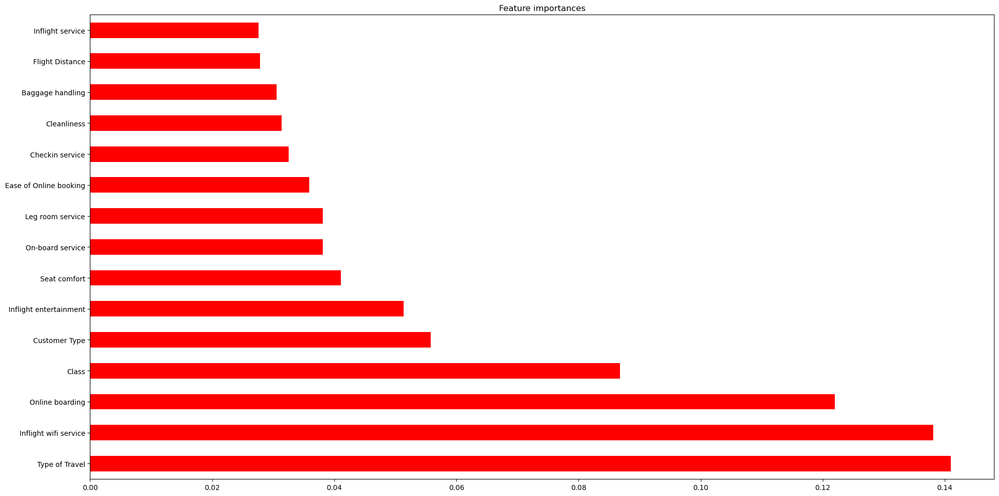

In [37]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.title('Feature importances')
feat=pd.Series(ex.feature_importances_,index=X.columns)
feat.nlargest(15).plot(kind='barh', color="r", align="center")
plt.tight_layout()
plt.grid(False)
plt.show()

In [38]:
X.drop(['Gender','Age','Departure/Arrival time convenient','Gate location','Food and drink'],axis=1,inplace=True)

In [39]:
from sklearn.model_selection import train_test_split ,cross_val_score,RandomizedSearchCV
X_train ,X_test,y_train ,y_test =train_test_split(X,y,test_size =.2 , random_state=42 , stratify=y)

Scaling

In [40]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
X_train=scaler.fit_transform(X_train)
X_test=scaler.fit_transform(X_test)

**try many ML models**

In [41]:
from sklearn.linear_model import LogisticRegression ,SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from xgboost.sklearn import XGBClassifier

In [42]:
models = {'Logistic Regression': LogisticRegression(),
         'KNN': KNeighborsClassifier(),
         'Decision Tree': DecisionTreeClassifier(),
         'Random Forest': RandomForestClassifier(),
         'Gradient Boosting Classifier':GradientBoostingClassifier(),
         'Support Vector Machine': SVC(),
         'Stochastic Gradien Descent': SGDClassifier(),
         'Naive Bayes': GaussianNB(),
         'xgb Classifier': XGBClassifier()}

In [43]:
def fit_score(models, X_train, X_test, y_train, y_test):
    np.random.seed(42)
    model_scores = {}
    for name, model in models.items():
        model.fit(X_train, y_train)
        model_scores[name] = cross_val_score(model,
                                             X_test,
                                             y_test,
                                            scoring='accuracy',
                                            cv=3
                                            ).mean()

    return model_scores

XGBOOST win

In [44]:
model_scores = fit_score(models,X_train,X_test,y_train,y_test)

model_scores

{'Logistic Regression': 0.8744526249939849,
 'KNN': 0.9213704826524228,
 'Decision Tree': 0.9311871421009575,
 'Random Forest': 0.9504354939608296,
 'Gradient Boosting Classifier': 0.9397526586786006,
 'Support Vector Machine': 0.9432173620133776,
 'Stochastic Gradien Descent': 0.8683412732784755,
 'Naive Bayes': 0.8654540204994947,
 'xgb Classifier': 0.9534189884991098}

<AxesSubplot:>

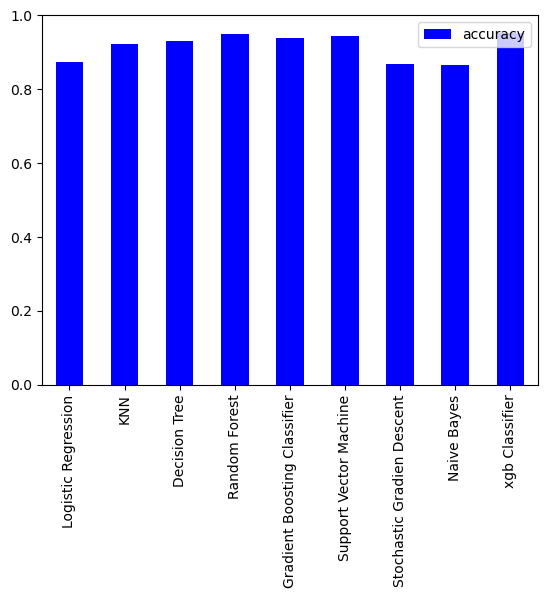

In [45]:
models = pd.DataFrame(model_scores, index=["accuracy"])
models.T.plot.bar(color="blue")

**Hyperparameter tuning**

In [46]:
np.random.seed(42)
params = {"n_estimators": [50,100,200, 300] ,
 'max_depth': [ 1,3, 18],
        'gamma': [1,9],
        'reg_alpha' : [40,180,1],
        'reg_lambda' :[ 0,1],}


xg = RandomizedSearchCV(XGBClassifier(),
                                param_distributions=params,
                                cv=3,
                                n_iter=100,
                                verbose=1,
                              refit=True,
                                n_jobs=-1
                               )

xg.fit(X_train, y_train)

xg.best_params_

Fitting 3 folds for each of 100 candidates, totalling 300 fits


{'reg_lambda': 0,
 'reg_alpha': 1,
 'n_estimators': 50,
 'max_depth': 18,
 'gamma': 9}

In [47]:
xg.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=9, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=18, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=50, n_jobs=0,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=1, reg_lambda=0, ...)

In [48]:
xg.best_score_

0.9602516757956961

In [49]:
xg.score(X_test, y_test)

0.9617439006785043

In [50]:
model = XGBClassifier(n_estimators= 50, reg_lambda= 0, reg_alpha=1, max_depth= 18,gamma=9)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

<AxesSubplot:>

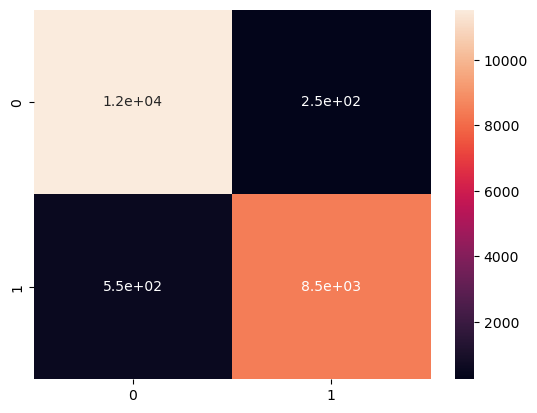

In [51]:
from sklearn.metrics import confusion_matrix, classification_report
sns.heatmap(pd.DataFrame(confusion_matrix(y_test,y_pred)) , annot=True)

In [52]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97     11776
           1       0.97      0.94      0.96      9005

    accuracy                           0.96     20781
   macro avg       0.96      0.96      0.96     20781
weighted avg       0.96      0.96      0.96     20781



**DL**

In [53]:
from tensorflow import keras
callback = keras.callbacks.EarlyStopping(monitor='loss', patience=10)

In [54]:
Model=keras.Sequential([keras.layers.Dense(100,activation='relu'),
                        keras.layers.Dense(50,activation='relu')
                        ,keras.layers.Dense(25,activation='relu'),
                           keras.layers.Dense(1,activation='sigmoid')])

In [55]:
Model.compile(loss='binary_crossentropy',optimizer='adam',metrics=['acc'])
history=Model.fit(X_train,y_train,epochs=128,batch_size=64,validation_split=0.2,callbacks=[callback],verbose=1)

Epoch 1/128
1040/1040 [==============================] - 4s 3ms/step - loss: 0.1867 - acc: 0.9259 - val_loss: 0.1430 - val_acc: 0.9423
Epoch 2/128
1040/1040 [==============================] - 3s 3ms/step - loss: 0.1271 - acc: 0.9483 - val_loss: 0.1233 - val_acc: 0.9486
Epoch 3/128
1040/1040 [==============================] - 3s 3ms/step - loss: 0.1144 - acc: 0.9525 - val_loss: 0.1186 - val_acc: 0.9503
Epoch 4/128
1040/1040 [==============================] - 3s 2ms/step - loss: 0.1076 - acc: 0.9553 - val_loss: 0.1130 - val_acc: 0.9543
Epoch 5/128
1040/1040 [==============================] - 3s 2ms/step - loss: 0.1034 - acc: 0.9558 - val_loss: 0.1168 - val_acc: 0.9504
Epoch 6/128
1040/1040 [==============================] - 3s 2ms/step - loss: 0.1000 - acc: 0.9573 - val_loss: 0.1077 - val_acc: 0.9541
Epoch 7/128
1040/1040 [==============================] - 3s 3ms/step - loss: 0.0970 - acc: 0.9589 - val_loss: 0.1093 - val_acc: 0.9559
Epoch 8/128
1040/1040 [==============================] 

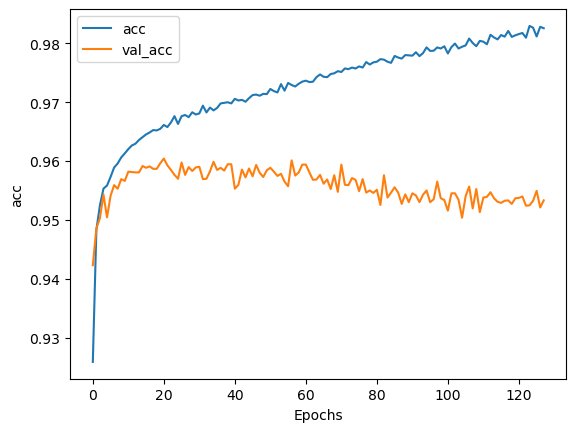

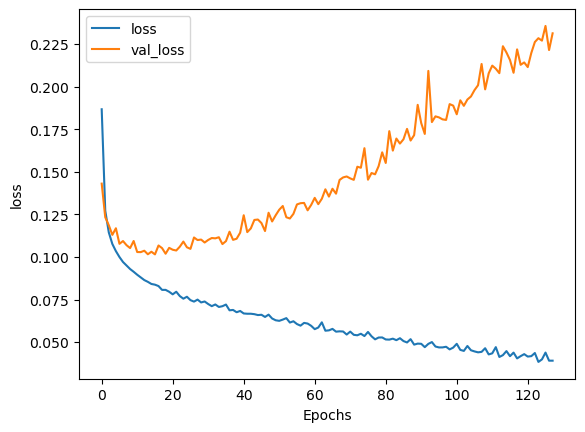

In [56]:
def plot_graphs(history,string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()
  
plot_graphs(history, "acc")
plot_graphs(history, "loss")

In [57]:
y_pred_deep=Model.predict(X_test)

650/650 [==============================] - 1s 1ms/step


<AxesSubplot:>

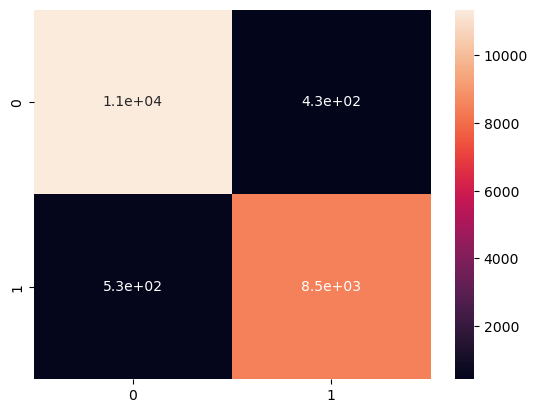

In [58]:
sns.heatmap(pd.DataFrame(confusion_matrix(y_test,y_pred_deep.round())) , annot=True)

In [59]:
print(classification_report(y_test, y_pred_deep.round()))

              precision    recall  f1-score   support

           0       0.96      0.96      0.96     11776
           1       0.95      0.94      0.95      9005

    accuracy                           0.95     20781
   macro avg       0.95      0.95      0.95     20781
weighted avg       0.95      0.95      0.95     20781



DONE!